# History Analysis - Australia's Accidents

This project aims to analyze the characteristics of the database with records of accidents in Australia between 1989 - 2021.

Our initial goal will be through predictive analysis, to draw profiles (personas) who have suffered accidents during this period and serve as a guide for creating strategies to reduce occurrences.
This study is divided into three parts:

1) Data cleaning and treatment

2) Exploratory analysis

3) Prediction mechanism: accident profile analysis using K-means

In [1]:
#Importing Python libs for Analysis:

import pandas as pd
import numpy as np
from sklearn.feature_selection import VarianceThreshold
from sklearn import preprocessing
import matplotlib.pyplot as plt 
plt.rc("font", size=14)
from matplotlib.colors import ListedColormap
%matplotlib inline
from sklearn.feature_selection import RFE
from sklearn.linear_model import LogisticRegression
from sklearn import metrics
from sklearn.metrics import confusion_matrix
from sklearn.metrics import classification_report
from sklearn.model_selection import train_test_split
import seaborn as sns
import plotly.express as px


#SMOTE (Para balancear a base):
from imblearn.over_sampling import SMOTE

#Curva ROC:
from sklearn.metrics import roc_auc_score
from sklearn.metrics import roc_curve

#para matriz de correlaçao (ver multicolinearidade):
from pandas_profiling import ProfileReport 

#Analise de grafos:
import networkx as nx

sns.set(style="white")
sns.set(style="whitegrid", color_codes=True)

## Data Cleaning

Loading the database:

In [2]:
data = pd.read_csv('C:/Users/Victoria/Documents/Git_Projects/case_australia_accidents/Australia.csv',delimiter=',',
                   dtype={'State':'string','Month':'string','Dayweek':'string','Crash Type':'string','Bus Involvement':'string',
                          'Heavy Rigid Truck Involvement':'string','Articulated Truck Involvement':'string','Speed Limit':'string',
                          'Speed Limit':'string','Gender':'string','National Remoteness Areas':'string','SA4 Name 2016':'string',
                          'National LGA Name 2017':'string','National Road Type':'string','Christmas Period':'string',
                          'Easter Period':'string','Age Group':'string','Age Group':'string','Day of week':'string',
                          'Time of day':'string','Road User':'string'})

data.head(n=5)

,Crash ID,State,Month,Year,Dayweek,Time,Crash Type,Bus Involvement,Heavy Rigid Truck Involvement,Articulated Truck Involvement,...,Age,National Remoteness Areas,SA4 Name 2016,National LGA Name 2017,National Road Type,Christmas Period,Easter Period,Age Group,Day of week,Time of day
0,20212133,Vic,9,2021,Sunday,0:30,Single,<NA>,<NA>,<NA>,...,38,Inner Regional Australia,Melbourne - Outer East,Yarra Ranges (S),Arterial Road,No,No,26_to_39,Weekend,Night
1,20214022,SA,9,2021,Saturday,23:31,Multiple,No,No,No,...,28,Major Cities of Australia,Adelaide - North,Playford (C),<NA>,No,No,26_to_39,Weekend,Night
2,20212096,Vic,9,2021,Saturday,23:00,Single,<NA>,<NA>,<NA>,...,19,Inner Regional Australia,Hume,Wangaratta (RC),Access road,No,No,17_to_25,Weekend,Night
3,20212145,Vic,9,2021,Saturday,22:25,Single,<NA>,<NA>,<NA>,...,23,Outer Regional Australia,Hume,Wangaratta (RC),Arterial Road,No,No,17_to_25,Weekend,Night
4,20212075,Vic,9,2021,Saturday,5:15,Single,<NA>,<NA>,<NA>,...,46,Major Cities of Australia,Melbourne - South East,Casey (C),Local Road,No,No,40_to_64,Weekend,Night


Checking base columns that are hidden in the above view:

In [3]:
data.iloc[:5,9:16]

,Articulated Truck Involvement,Speed Limit,Road User,Gender,Age,National Remoteness Areas,SA4 Name 2016
0,<NA>,<NA>,Motorcycle rider,Male,38,Inner Regional Australia,Melbourne - Outer East
1,No,110,Pedestrian,Female,28,Major Cities of Australia,Adelaide - North
2,<NA>,<NA>,Passenger,Male,19,Inner Regional Australia,Hume
3,<NA>,<NA>,Driver,Male,23,Outer Regional Australia,Hume
4,<NA>,<NA>,Motorcycle rider,Male,46,Major Cities of Australia,Melbourne - South East


In [4]:
data.iloc[:5,16:23]

,National LGA Name 2017,National Road Type,Christmas Period,Easter Period,Age Group,Day of week,Time of day
0,Yarra Ranges (S),Arterial Road,No,No,26_to_39,Weekend,Night
1,Playford (C),<NA>,No,No,26_to_39,Weekend,Night
2,Wangaratta (RC),Access road,No,No,17_to_25,Weekend,Night
3,Wangaratta (RC),Arterial Road,No,No,17_to_25,Weekend,Night
4,Casey (C),Local Road,No,No,40_to_64,Weekend,Night


## Useful base information:

#### Glossary:

•	Crash ID: number of the crash;

•	State;

•	Month;

•	Year;

•	Dayweek;

•	Time: time of the crash;

•	Crash Type: type of crash (individual or multiple);

•	Bus Involvement: accident with a bus involved;

•	Heavy Rigid Truck Involvement: accident with large vehicles involved (we will consider in this case, trucks);

•	Articulated Truck Involvement: accident with articulated vehicles involved (articulated buses, tractors, trailers, etc);

•	Speed Limit;

•	Road User: evaluates if the person involved in the accident is a driver, motorcyclist (driver and rider), pedestrian, cyclist, etc;

•	Gender (male, female or not defined);

•	Age

•	National Remoteness Areas: verifies if the accident happened in regions according to distance from other states. We can also infer that the regions in this field can refer to the demographic density of the place;

•	SA4 Name 2016: name of the city;

•	National LGA Name 2017: equivalent to administrative region;

•	National Road Type: road type (if the road is an autobahn for example);

•	Christmas Period: binary variable, indicating if there was an accident at Christmas time;

•	Easter Period: binary variable, indicating if there was an accident during the Easter season;

•	Age Group;

•	Day of week: indicates whether the accident occurred on a weekday or on the weekend;

•	Time of day: accidents during the day or at night.


#### Names of Australian states according to their acronyms:

•	ACT: Australian Capital Territory;

•	NSW: New South Wales;

•	NT: Northern Territory;

•	Qld: Queensland;

•	SA: South Australia;

•	Tas: Tasmania;

•	Vic: Victoria;

•	WA: Western Australia.


In [5]:
#remove spaces from column names:
data.rename(columns = {'Crash ID':'id','Crash Type':'crash_type','Bus Involvement':'bus_involved','Heavy Rigid Truck Involvement':'heavy_truck_invol'
                        ,'Articulated Truck Involvement':'articulated_invol','Speed Limit':'speed_limit','Road User':'road_user'
             ,'National Remoteness Areas':'nat_areas','SA4 Name 2016':'sa4_name','National LGA Name 2017':'national_name',
             'National Road Type':'road_type','Christmas Period':'christmas_period','Easter Period':'easter_period',
             'Age Group':'age_group','Day of week':'day_week','Time of day':'time_of_day'}
             ,inplace = True)


print(list(data.columns))

data.head(n=5)

['id', 'State', 'Month', 'Year', 'Dayweek', 'Time', 'crash_type', 'bus_involved', 'heavy_truck_invol', 'articulated_invol', 'speed_limit', 'road_user', 'Gender', 'Age', 'nat_areas', 'sa4_name', 'national_name', 'road_type', 'christmas_period', 'easter_period', 'age_group', 'day_week', 'time_of_day']


,id,State,Month,Year,Dayweek,Time,crash_type,bus_involved,heavy_truck_invol,articulated_invol,...,Age,nat_areas,sa4_name,national_name,road_type,christmas_period,easter_period,age_group,day_week,time_of_day
0,20212133,Vic,9,2021,Sunday,0:30,Single,<NA>,<NA>,<NA>,...,38,Inner Regional Australia,Melbourne - Outer East,Yarra Ranges (S),Arterial Road,No,No,26_to_39,Weekend,Night
1,20214022,SA,9,2021,Saturday,23:31,Multiple,No,No,No,...,28,Major Cities of Australia,Adelaide - North,Playford (C),<NA>,No,No,26_to_39,Weekend,Night
2,20212096,Vic,9,2021,Saturday,23:00,Single,<NA>,<NA>,<NA>,...,19,Inner Regional Australia,Hume,Wangaratta (RC),Access road,No,No,17_to_25,Weekend,Night
3,20212145,Vic,9,2021,Saturday,22:25,Single,<NA>,<NA>,<NA>,...,23,Outer Regional Australia,Hume,Wangaratta (RC),Arterial Road,No,No,17_to_25,Weekend,Night
4,20212075,Vic,9,2021,Saturday,5:15,Single,<NA>,<NA>,<NA>,...,46,Major Cities of Australia,Melbourne - South East,Casey (C),Local Road,No,No,40_to_64,Weekend,Night


In [6]:
#Deleting duplicate rows:
data.drop_duplicates (subset = None, keep = 'first', inplace = True)

In [7]:
#Counting null values in each column:
data.isna().sum()

id                       0
State                    0
Month                    0
Year                     0
Dayweek                  0
Time                    40
crash_type               0
bus_involved            22
heavy_truck_invol    20439
articulated_invol       22
speed_limit            698
road_user                0
Gender                  23
Age                      0
nat_areas            45824
sa4_name             45810
national_name        45809
road_type            45825
christmas_period         0
easter_period            0
age_group               81
day_week                 0
time_of_day              0
dtype: int64

#### Point of attention:

We have a large amount of NAs, so we cannot simply delete the values because it would entail a deletion of 45,966 rows.

In this case, the columns with the most critical situation are: heavy_truck_invol, national_name, sa4_name and road_type

With the exception of the heavy_truck_invol column, we can infer that analyzing the Australian accidents based on geographical premises has great chances of generating failures in models, especially the probabilistic ones, such as linear and logistic regressions; being plausible to eliminate these columns from the dataset.

In [8]:
#Replace cells with null values:

data['Time'].fillna('00:00', inplace = True)
data['bus_involved'].fillna("No", inplace = True)
data['heavy_truck_invol'].fillna("No", inplace = True)
data['articulated_invol'].fillna("No", inplace = True)
data['speed_limit'].fillna("0", inplace = True)
data['Gender'].fillna('Unspecified', inplace = True)
data['nat_areas'].fillna('All Regions', inplace = True)
data['sa4_name'].fillna('Unspecified', inplace = True)
data['national_name'].fillna('Unspecified', inplace = True)
data['road_type'].fillna('Undetermined', inplace = True)
data['age_group'].fillna('0_to_16', inplace = True)
# 
data.head(n=10)

,id,State,Month,Year,Dayweek,Time,crash_type,bus_involved,heavy_truck_invol,articulated_invol,...,Age,nat_areas,sa4_name,national_name,road_type,christmas_period,easter_period,age_group,day_week,time_of_day
0,20212133,Vic,9,2021,Sunday,0:30,Single,No,No,No,...,38,Inner Regional Australia,Melbourne - Outer East,Yarra Ranges (S),Arterial Road,No,No,26_to_39,Weekend,Night
1,20214022,SA,9,2021,Saturday,23:31,Multiple,No,No,No,...,28,Major Cities of Australia,Adelaide - North,Playford (C),Undetermined,No,No,26_to_39,Weekend,Night
2,20212096,Vic,9,2021,Saturday,23:00,Single,No,No,No,...,19,Inner Regional Australia,Hume,Wangaratta (RC),Access road,No,No,17_to_25,Weekend,Night
3,20212145,Vic,9,2021,Saturday,22:25,Single,No,No,No,...,23,Outer Regional Australia,Hume,Wangaratta (RC),Arterial Road,No,No,17_to_25,Weekend,Night
4,20212075,Vic,9,2021,Saturday,5:15,Single,No,No,No,...,46,Major Cities of Australia,Melbourne - South East,Casey (C),Local Road,No,No,40_to_64,Weekend,Night
5,20213034,Qld,9,2021,Saturday,4:00,Multiple,No,No,No,...,19,Major Cities of Australia,Brisbane - South,Brisbane (C),Busway,No,No,17_to_25,Weekend,Night
6,20215071,WA,9,2021,Saturday,19:10,Single,No,No,No,...,20,All Regions,Unspecified,Unspecified,Undetermined,No,No,17_to_25,Weekend,Night
7,20212015,Vic,9,2021,Thursday,19:33,Multiple,No,No,No,...,17,Major Cities of Australia,Melbourne - West,Wyndham (C),Sub-arterial Road,No,No,17_to_25,Weekday,Night
8,20213026,Qld,9,2021,Wednesday,23:00,Multiple,No,No,No,...,2,Major Cities of Australia,Ipswich,Ipswich (C),National or State Highway,No,No,0_to_16,Weekday,Night
9,20213092,Qld,9,2021,Saturday,2:00,Single,No,No,No,...,47,Major Cities of Australia,Logan - Beaudesert,Logan (C),Local Road,No,No,40_to_64,Weekend,Night


In [9]:
#checking column formats:
data.dtypes

id                    int64
State                string
Month                string
Year                  int64
Dayweek              string
Time                 object
crash_type           string
bus_involved         string
heavy_truck_invol    string
articulated_invol    string
speed_limit          string
road_user            string
Gender               string
Age                   int64
nat_areas            string
sa4_name             string
national_name        string
road_type            string
christmas_period     string
easter_period        string
age_group            string
day_week             string
time_of_day          string
dtype: object

In [11]:
#Removing characters that might hinder the field conversion to number:

data.loc[data['speed_limit'] == '<40'] = '0'
data

,id,State,Month,Year,Dayweek,Time,crash_type,bus_involved,heavy_truck_invol,articulated_invol,...,Age,nat_areas,sa4_name,national_name,road_type,christmas_period,easter_period,age_group,day_week,time_of_day
0,20212133,Vic,9,2021,Sunday,0:30,Single,No,No,No,...,38,Inner Regional Australia,Melbourne - Outer East,Yarra Ranges (S),Arterial Road,No,No,26_to_39,Weekend,Night
1,20214022,SA,9,2021,Saturday,23:31,Multiple,No,No,No,...,28,Major Cities of Australia,Adelaide - North,Playford (C),Undetermined,No,No,26_to_39,Weekend,Night
2,20212096,Vic,9,2021,Saturday,23:00,Single,No,No,No,...,19,Inner Regional Australia,Hume,Wangaratta (RC),Access road,No,No,17_to_25,Weekend,Night
3,20212145,Vic,9,2021,Saturday,22:25,Single,No,No,No,...,23,Outer Regional Australia,Hume,Wangaratta (RC),Arterial Road,No,No,17_to_25,Weekend,Night
4,20212075,Vic,9,2021,Saturday,5:15,Single,No,No,No,...,46,Major Cities of Australia,Melbourne - South East,Casey (C),Local Road,No,No,40_to_64,Weekend,Night
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
52837,19891659,NSW,1,1989,Saturday,10:00,Single,No,No,No,...,72,All Regions,Unspecified,Unspecified,Undetermined,No,No,65_to_74,Weekend,Day
52838,19891246,NSW,1,1989,Wednesday,17:05,Single,Yes,No,No,...,5,All Regions,Unspecified,Unspecified,Undetermined,No,No,0_to_16,Weekday,Day
52839,19895088,WA,1,1989,Monday,6:00,Single,No,No,No,...,19,All Regions,Unspecified,Unspecified,Undetermined,Yes,No,17_to_25,Weekday,Day
52840,19895088,WA,1,1989,Monday,6:00,Single,No,No,No,...,17,All Regions,Unspecified,Unspecified,Undetermined,Yes,No,17_to_25,Weekday,Day


In [13]:
#For convention, let's assume that the unspecified speed limit is zero:

data.loc[data['speed_limit'] == 'Unspecified'] = '0'

In [14]:
#Converting the speed_limit column to number:
data['speed_limit'] = data['speed_limit'].astype(float)

In [15]:
#checking column formats:
data.dtypes

id                    object
State                 string
Month                 string
Year                  object
Dayweek               string
Time                  object
crash_type            string
bus_involved          string
heavy_truck_invol     string
articulated_invol     string
speed_limit          float64
road_user             string
Gender                string
Age                   object
nat_areas             string
sa4_name              string
national_name         string
road_type             string
christmas_period      string
easter_period         string
age_group             string
day_week              string
time_of_day           string
dtype: object

In [16]:
#convert column age to number:
data['Age'] = data['Age'].astype(float)

In [17]:
#checking column formats:
data.dtypes

id                    object
State                 string
Month                 string
Year                  object
Dayweek               string
Time                  object
crash_type            string
bus_involved          string
heavy_truck_invol     string
articulated_invol     string
speed_limit          float64
road_user             string
Gender                string
Age                  float64
nat_areas             string
sa4_name              string
national_name         string
road_type             string
christmas_period      string
easter_period         string
age_group             string
day_week              string
time_of_day           string
dtype: object

In [18]:
#creating binary column for accidents by time of day:

data['crash_night'] = np.where(data['time_of_day'] == 'Day', 1, 0)

#creating binary column for night time accidents:

data['crash_night'] = np.where(data['time_of_day'] == 'Night', 1, 0)

#creating binary column for weekday accidents:

data['crash_week']= np.where(data['day_week'] == 'Weekday', 1, 0)

#creating binary column for weekend accidents:

data['crash_wknd']= np.where(data['day_week'] == 'Weekend', 1, 0)

data.head(n=10)

,id,State,Month,Year,Dayweek,Time,crash_type,bus_involved,heavy_truck_invol,articulated_invol,...,national_name,road_type,christmas_period,easter_period,age_group,day_week,time_of_day,crash_night,crash_week,crash_wknd
0,20212133,Vic,9,2021,Sunday,0:30,Single,No,No,No,...,Yarra Ranges (S),Arterial Road,No,No,26_to_39,Weekend,Night,1,0,1
1,20214022,SA,9,2021,Saturday,23:31,Multiple,No,No,No,...,Playford (C),Undetermined,No,No,26_to_39,Weekend,Night,1,0,1
2,20212096,Vic,9,2021,Saturday,23:00,Single,No,No,No,...,Wangaratta (RC),Access road,No,No,17_to_25,Weekend,Night,1,0,1
3,20212145,Vic,9,2021,Saturday,22:25,Single,No,No,No,...,Wangaratta (RC),Arterial Road,No,No,17_to_25,Weekend,Night,1,0,1
4,20212075,Vic,9,2021,Saturday,5:15,Single,No,No,No,...,Casey (C),Local Road,No,No,40_to_64,Weekend,Night,1,0,1
5,20213034,Qld,9,2021,Saturday,4:00,Multiple,No,No,No,...,Brisbane (C),Busway,No,No,17_to_25,Weekend,Night,1,0,1
6,20215071,WA,9,2021,Saturday,19:10,Single,No,No,No,...,Unspecified,Undetermined,No,No,17_to_25,Weekend,Night,1,0,1
7,20212015,Vic,9,2021,Thursday,19:33,Multiple,No,No,No,...,Wyndham (C),Sub-arterial Road,No,No,17_to_25,Weekday,Night,1,1,0
8,20213026,Qld,9,2021,Wednesday,23:00,Multiple,No,No,No,...,Ipswich (C),National or State Highway,No,No,0_to_16,Weekday,Night,1,1,0
9,20213092,Qld,9,2021,Saturday,2:00,Single,No,No,No,...,Logan (C),Local Road,No,No,40_to_64,Weekend,Night,1,0,1


In [19]:
data.isna().sum()

id                   0
State                0
Month                0
Year                 0
Dayweek              0
Time                 0
crash_type           0
bus_involved         0
heavy_truck_invol    0
articulated_invol    0
speed_limit          0
road_user            0
Gender               0
Age                  0
nat_areas            0
sa4_name             0
national_name        0
road_type            0
christmas_period     0
easter_period        0
age_group            0
day_week             0
time_of_day          0
crash_night          0
crash_week           0
crash_wknd           0
dtype: int64

In [20]:
#Removing zeros from categorical variables:

data = data[data.State != '0']
data = data[data.Dayweek != '0']
data = data[data.Gender != '0']
data = data[data.crash_type != '0']
data = data[data.road_type != '0']
data = data[data.age_group != '0']
data = data[data.day_week != '0']
data = data[data.time_of_day != '0']

# Exploratory Analysis

This analysis focuses on understanding the behavior of some interesting variables, so that we can choose the best predictive model to understand the personas that have suffered accidents according to the established speed limit and age of the accident victim.

#### Analysis of accidents according to the number of accidents that occurred during the weekend:

In [21]:
#Let's use the created binary variable that counts the weekend accidents:
data.groupby('crash_wknd').mean()

,speed_limit,Age,crash_night,crash_week
crash_wknd,,,,
0,80.383384,42.420261,0.326504,1.0
1,81.291156,35.832380,0.577054,0.0


In [22]:
data['crash_wknd'].value_counts()

0    30995
1    21686
Name: crash_wknd, dtype: int64

In absolute terms, we have more accidents on weekdays than on Saturdays and Sundays. On both weekdays and weekends, the average speed of the roads remains around 80km/h, and the average age of those killed during the whole period is around 35-42 years old.

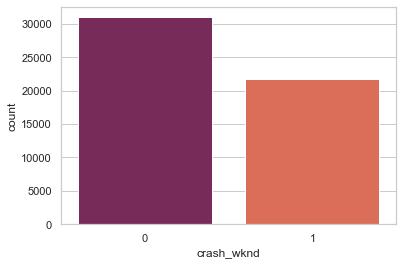

In [23]:
sns.countplot(x='crash_wknd',data=data, palette="rocket")
plt.show()

In [24]:
count_no_sub = len(data[data['crash_wknd']==0])
count_sub = len(data[data['crash_wknd']==1])
pct_of_no_sub = count_no_sub/(count_no_sub+count_sub)
print("% of accidents during the week: ", pct_of_no_sub*100)
pct_of_sub = count_sub/(count_no_sub+count_sub)
print("% of accidents during the weekend: ", pct_of_sub*100)

% of accidents during the week:  58.83525369677872
% of accidents during the weekend:  41.16474630322128


Here we have a curious fact: we have more accidents during the week.

#### Accident analysis through the state variable:

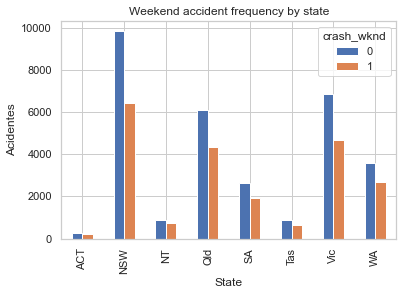

In [25]:
%matplotlib inline
pd.crosstab(data.State,data.crash_wknd).plot(kind='bar')
plt.title('Weekend accident frequency by state')
plt.xlabel('State')
plt.ylabel('Acidentes')
plt.savefig('wknd')

Here we have a point of attention: New South Wales has the highest occurrences of accidents in general (especially during the week, since the base has only accident records).

An interesting fact: the most populated city in Australia (Sydney) is located in this state, which allows us to consider this result in line with what we have seen so far.


In the graph below, we can see over the years the behavior in the speed limit per state according to the years (both age of the injured and period) available in the base:

In [26]:
px.scatter(data, x="speed_limit", y="Age", animation_frame="Year", animation_group="State",
           size="crash_wknd", color="State", hover_name="State",
           log_x=True, size_max=55, range_x=[10,150], range_y=[0,110])

In the graph above, we can see the tendency of accidents on weekends to be caused by young people, mostly on roads with speed limits above 50km/h.

#### Analysis of accidents according to gender:

In [27]:
data.groupby('Gender').mean()

,speed_limit,Age,crash_night,crash_week,crash_wknd
Gender,,,,,
Female,81.277161,43.125502,0.327134,0.631523,0.368477
Male,80.548198,38.379273,0.470445,0.571163,0.428837
Unspecified,85.000000,-0.291667,0.166667,0.708333,0.291667


Here we can see that the historical average rises in relation to the first scatter plot, corroborating the information that most accidents occur during the week, and also providing an indication of the decrease in accidents among people over 35 years of age from 1989 (beginning of the traffic awareness campaign) until 2021 (last year present in the database).

After this brief observation, let us return to the focus of this topic, which is to analyze the data from the gender variable:

In [28]:
data.groupby('Gender').count()

,id,State,Month,Year,Dayweek,Time,crash_type,bus_involved,heavy_truck_invol,articulated_invol,...,national_name,road_type,christmas_period,easter_period,age_group,day_week,time_of_day,crash_night,crash_week,crash_wknd
Gender,,,,,,,,,,,,,,,,,,,,,
Female,14948,14948,14948,14948,14948,14948,14948,14948,14948,14948,...,14948,14948,14948,14948,14948,14948,14948,14948,14948,14948
Male,37709,37709,37709,37709,37709,37709,37709,37709,37709,37709,...,37709,37709,37709,37709,37709,37709,37709,37709,37709,37709
Unspecified,24,24,24,24,24,24,24,24,24,24,...,24,24,24,24,24,24,24,24,24,24


In [29]:
count_gen_sub = len(data[data['Gender']=='Male'])
count_sub1 = len(data[data['Gender']=='Female'])
count_subu = len(data[data['Gender']=='Unspecified'])
pct_of_no_sub1 = count_gen_sub/(count_gen_sub+count_sub1+count_subu)
print("% of men in accidents: ", pct_of_no_sub1*100)
pct_of_sub1 = count_sub1/(count_gen_sub+count_sub1+count_subu)
print("% of women in accidents: ", pct_of_sub1*100)

% of men in accidents:  71.57988648658909
% of women in accidents:  28.37455629164215


Here we have a big difference between the genders. Should we pay special attention to men in the next campaigns? 

Do we have much difference in the amount of occurrences per state?

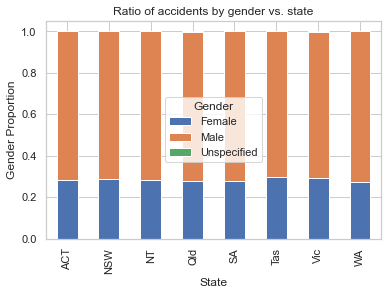

In [30]:
table=pd.crosstab(data.State,data.Gender)
table.div(table.sum(1).astype(float), axis=0).plot(kind='bar', stacked=True)
plt.title('Ratio of accidents by gender vs. state')
plt.xlabel('State')
plt.ylabel('Gender Proportion')
plt.savefig('gender_vs_state')

Here we can confirm that the behavior between genders remains homogeneous in all states.

In [31]:
data.groupby('Gender').mean()

,speed_limit,Age,crash_night,crash_week,crash_wknd
Gender,,,,,
Female,81.277161,43.125502,0.327134,0.631523,0.368477
Male,80.548198,38.379273,0.470445,0.571163,0.428837
Unspecified,85.000000,-0.291667,0.166667,0.708333,0.291667


In all the states present in the base, men have more than 50% more accidents than women, which raises an alert for the authorities about male traffic behavior, which will require a behavioral study of the population to understand the real reasons and mitigate future accidents.

#### Accidents according to days of the week:

In [32]:
fig = px.pie(data, values='id', 
             names='Dayweek',  
             color_discrete_sequence=px.colors.sequential.RdBu) 
fig.show()

Here we have a homogeneous division, with accidents mainly on Friday and Saturday, which can be a sign that accidents on these days of the week involve trips, going to parties, festivals, and even a possible relationship between substance consumption and driving, even with the existing policy of low tolerance to alcohol (which should be analyzed in another study).

Note: in this chart we can observe that the base considers Friday a weekend day.

#### Accident analysis according to the time of day:

In [33]:
data['crash_night'].value_counts()

0    30047
1    22634
Name: crash_night, dtype: int64

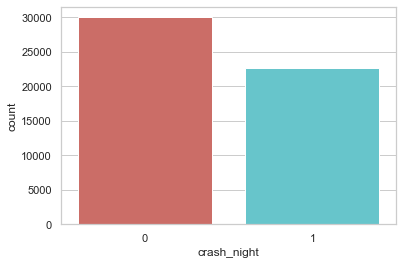

In [34]:
sns.countplot(x='crash_night',data=data, palette='hls')
plt.show()

In [35]:
data.groupby('crash_night').mean()

,speed_limit,Age,crash_week,crash_wknd
crash_night,,,,
0,82.057743,44.592805,0.694745,0.305255
1,79.030397,33.224220,0.447115,0.552885


In [36]:
count_no_sub1 = len(data[data['crash_night']==0])
count_sub1 = len(data[data['crash_night']==1])
pct_of_no_sub1 = count_no_sub1/(count_no_sub1+count_sub1)
print("% of accidents during the day: ", pct_of_no_sub1*100)
pct_of_sub1 = count_sub1/(count_no_sub1+count_sub1)
print("% of accidents during the night: ", pct_of_sub1*100)

% of accidents during the day:  57.03574343691273
% of accidents during the night:  42.96425656308726


We can observe an interesting fact, that on average more than half of the accidents that occur on the weekend are at night, with an average age of 33.

#### Analysis of accidents according to age:

In this topic, we will analyze what age in relation to other explanatory variables can tell us about the history of accidents:

Initially we will check the proportion of accidents according to the pre-determined age groupings in the base:

In [37]:
fig2 = px.pie(data, values='id', 
             names='age_group',  
             color_discrete_sequence=px.colors.sequential.RdBu) 
fig2.show()

Approximately 3/4 of the accidents involved citizens aged 17 - 39.

In the graph below we can check if there are peaks of accidents in a lower age range (can we find a higher concentration of occurrences?) 

C:\Users\Victoria\anaconda3\lib\site-packages\seaborn\distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



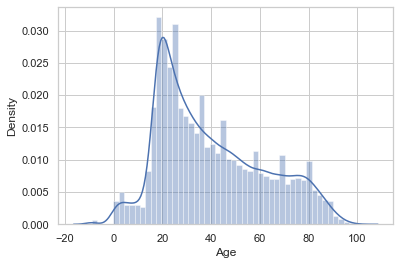

In [38]:
sns.distplot(data['Age']);

We can observe the prevalence of accidents between two groups (17-25 and 26-39 years old), especially between 20 and 30 years old, which can be attributed to several behaviors such as a tendency to greater social/labor activity, besides having an expected asymmetry to the right, since adolescents are not allowed to drive. We can also consider the possibility that most accidents occur with car drivers.

Checking the average speed of accidents according to the established age range:

In [39]:
data.groupby('age_group').mean()

,speed_limit,Age,crash_night,crash_week,crash_wknd
age_group,,,,,
0_to_16,78.413133,9.257572,0.363945,0.596559,0.403441
17_to_25,80.330339,20.723342,0.591878,0.491747,0.508253
26_to_39,82.100980,31.886630,0.527897,0.551381,0.448619
40_to_64,83.838070,50.786007,0.368763,0.622138,0.377862
65_to_74,80.045477,69.424038,0.210645,0.701649,0.298351
75_or_older,73.010384,81.786050,0.141458,0.752743,0.247257


Now, let's look at the behavior of age according to state:

(-0.5, 7.5, 0.0, 110.0)

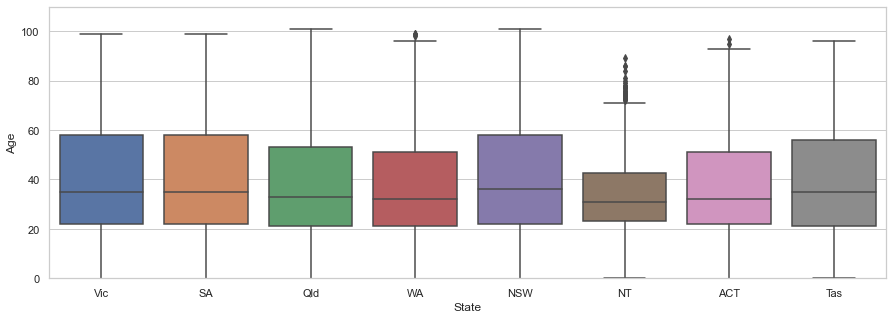

In [40]:
var = 'State'
dt = pd.concat([data['Age'], data[var]], axis=1)
f, ax = plt.subplots(figsize=(15,5))
fig = sns.boxplot(x=var, y='Age', data = dt)
fig.axis(ymin=0, ymax=110.000000 )

In NT, whose territory has a geography that favors isolation among the other regions, we noticed a strong presence of outliers, which can alert us to whether the older population has greater difficulties with the state's roads or whether the state has a larger number of older people.

In general, the population between 30 and 40, suffered more occurrences.

With the scatter plot below, we can get a very interesting view of the profile of accident victims according to age during the weekends:

In [41]:
px.scatter(data, x="speed_limit", y="Age", animation_frame="Year", animation_group="State",
           size="crash_wknd", color="road_user", hover_name="road_user",
           log_x=True, size_max=55, range_x=[10,150], range_y=[0,110])

We can observe some interesting data: 
    
•	Presence of pedestrians on roads with a maximum speed of 50km/h, giving clue that these are mostly urban roads with an average speed limit of 50km/h;

•	Accidents with car drivers tend to happen on roads with a maximum speed between 100-110km/h;

•	The profile of injured cyclists revolves around teenagers and people 50 and older;

•	When we follow the trajectory of accidents in the graph we can observe the age decreasing according to the profile of the injured person in general.


Both on weekends and weekdays, there are more occurrences of accidents in places with a higher speed limit.

#### Age vs. day of the week:

(-0.5, 6.5, 0.0, 110.0)

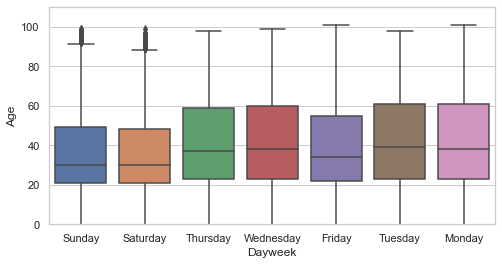

In [43]:
var = 'Dayweek'
dt = pd.concat([data['Age'], data[var]], axis=1)
f, ax = plt.subplots(figsize=(8,4))
fig = sns.boxplot(x=var, y='Age', data = dt)
fig.axis(ymin=0, ymax=110.000000 )

Now, let's do the last explorations to understand the basis. 

Let's evaluate the amount of accidents according to the months of the year:

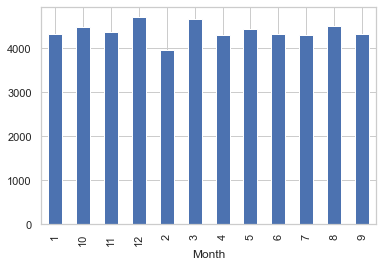

In [44]:
data.groupby('Month')['id'].count().plot.bar();

We can observe a graphically homogeneous distribution during the months of the year, which is a good sign, because vacation periods did not tend to present greater danger to the population. This behavior can also indicate a possible effectiveness of the campaign with an adhesion from the population when we notice higher amounts of accidents during the week.

#### Analyzing correlations:

To begin to orient ourselves on the quality of the data and choose a problematic to explore, let's look at the correlations that exist between the columns in the base and see how they behave in a heatmap:

In [45]:
data_cor=data.corr()
data_cor

,speed_limit,Age,crash_night,crash_week,crash_wknd
speed_limit,1.000000,-0.037628,-0.060740,-0.018107,0.018107
Age,-0.037628,1.000000,-0.258212,0.148755,-0.148755
crash_night,-0.060740,-0.258212,1.000000,-0.249086,0.249086
crash_week,-0.018107,0.148755,-0.249086,1.000000,-1.000000
crash_wknd,0.018107,-0.148755,0.249086,-1.000000,1.000000


<AxesSubplot:>

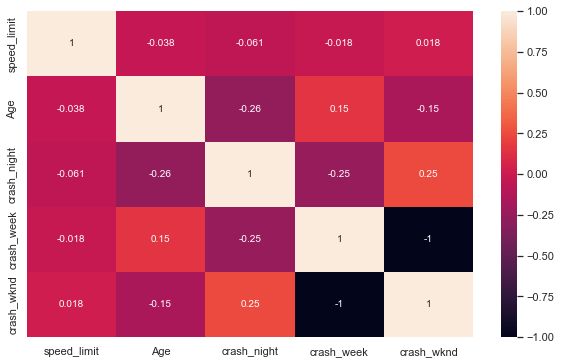

In [46]:
%matplotlib inline 
plt.figure(figsize=(10,6)) 
sns.heatmap(data_cor, annot=True)

Here we can see the following correlations:

•	Age and spped_limit;

•	Crash_night and age;

•	Crash_week and age


Since we verified a high value of nulls in the columns with geographic information, we will create a new dataset, removing all columns except the State column (the only one without null values at the time of the base export).

We will also eliminate the Time column, as it has high cardinality.

High cardinality means that there may be many possible values for a single assignment.

In [47]:
data_id = data.drop(columns=['sa4_name','nat_areas','national_name','heavy_truck_invol','road_type','Time',])
data_id 

,id,State,Month,Year,Dayweek,crash_type,bus_involved,articulated_invol,speed_limit,road_user,Gender,Age,christmas_period,easter_period,age_group,day_week,time_of_day,crash_night,crash_week,crash_wknd
0,20212133,Vic,9,2021,Sunday,Single,No,No,0.0,Motorcycle rider,Male,38.0,No,No,26_to_39,Weekend,Night,1,0,1
1,20214022,SA,9,2021,Saturday,Multiple,No,No,110.0,Pedestrian,Female,28.0,No,No,26_to_39,Weekend,Night,1,0,1
2,20212096,Vic,9,2021,Saturday,Single,No,No,0.0,Passenger,Male,19.0,No,No,17_to_25,Weekend,Night,1,0,1
3,20212145,Vic,9,2021,Saturday,Single,No,No,0.0,Driver,Male,23.0,No,No,17_to_25,Weekend,Night,1,0,1
4,20212075,Vic,9,2021,Saturday,Single,No,No,0.0,Motorcycle rider,Male,46.0,No,No,40_to_64,Weekend,Night,1,0,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
52837,19891659,NSW,1,1989,Saturday,Single,No,No,60.0,Driver,Male,72.0,No,No,65_to_74,Weekend,Day,0,0,1
52838,19891246,NSW,1,1989,Wednesday,Single,Yes,No,60.0,Passenger,Female,5.0,No,No,0_to_16,Weekday,Day,0,1,0
52839,19895088,WA,1,1989,Monday,Single,No,No,110.0,Passenger,Male,19.0,Yes,No,17_to_25,Weekday,Day,0,1,0
52840,19895088,WA,1,1989,Monday,Single,No,No,110.0,Passenger,Male,17.0,Yes,No,17_to_25,Weekday,Day,0,1,0


In [48]:
data_id.dtypes

id                    object
State                 string
Month                 string
Year                  object
Dayweek               string
crash_type            string
bus_involved          string
articulated_invol     string
speed_limit          float64
road_user             string
Gender                string
Age                  float64
christmas_period      string
easter_period         string
age_group             string
day_week              string
time_of_day           string
crash_night            int32
crash_week             int32
crash_wknd             int32
dtype: object

Variables with high correlation:

df_index, id, State, Month, Dayweek, crash_type, speed_limit, Age, age_group, day_week, time_of_day. The variables crash_wknd and crash_night have a high correlation because they are binary columns created directly in this notebook.

## Predictive Mechanism 1: K-Means

According to the first heatmap, we found a slightly negative correlation between road speed at the time of the crash versus the age of the crash victim. We will use these variables since the major correlations are based on binary variables and our focus is to perform an analysis under the K-means algorithm.

Given this finding, we can verify which personas/groups exist according to the occurrences of accidents, in order to think of insights to decrease the amount of future accidents in Australia, according to the data available in the databases.

The concept of centroids present in K-means can help us to draw specific profiles for the implementation of public policies.

In [57]:
#slicing the dataset for clustering:

X = data[['Age','speed_limit']]
X = X.values
X


array([[ 38.,   0.],
       [ 28., 110.],
       [ 19.,   0.],
       ...,
       [ 19., 110.],
       [ 17., 110.],
       [ 63.,  60.]])

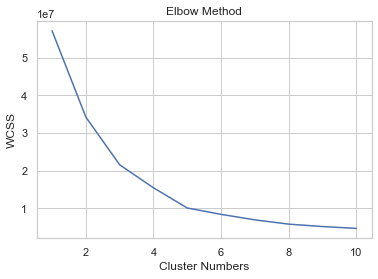

In [58]:
#Now let's find out how many profiles we have within our base:

from sklearn.cluster import KMeans
wcss = []
for i in range(1, 11):
    kmeans = KMeans(n_clusters = i, init = 'k-means++', random_state = 42)
    kmeans.fit(X)
    wcss.append(kmeans.inertia_)
plt.plot(range(1, 11), wcss)
plt.title('Elbow Method')
plt.xlabel('Cluster Numbers')
plt.ylabel('WCSS')
plt.show()

According to the Elbow method, the number of clusters should be set at the point where the sharp drop in the curve ceases.

In [59]:
kmeans = KMeans(n_clusters = 5, init = 'k-means++', random_state = 42)
y_kmeans = kmeans.fit_predict(X)


In [60]:
y_kmeans

array([3, 2, 3, ..., 2, 2, 0])

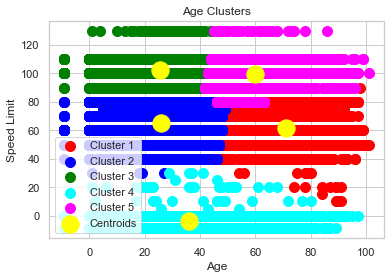

In [61]:
plt.scatter(X[y_kmeans == 0, 0], X[y_kmeans == 0, 1], s = 100, c = 'red', label = 'Cluster 1')
plt.scatter(X[y_kmeans == 1, 0], X[y_kmeans == 1, 1], s = 100, c = 'blue', label = 'Cluster 2')
plt.scatter(X[y_kmeans == 2, 0], X[y_kmeans == 2, 1], s = 100, c = 'green', label = 'Cluster 3')
plt.scatter(X[y_kmeans == 3, 0], X[y_kmeans == 3, 1], s = 100, c = 'cyan', label = 'Cluster 4')
plt.scatter(X[y_kmeans == 4, 0], X[y_kmeans == 4, 1], s = 100, c = 'magenta', label = 'Cluster 5')
plt.scatter(kmeans.cluster_centers_[:, 0], kmeans.cluster_centers_[:, 1], s = 300, c = 'yellow', label = 'Centroids')
plt.title('Age Clusters')
plt.xlabel('Age')
plt.ylabel('Speed Limit')
plt.legend()
plt.show()

According to the dataset, we have 5 personas (5 centroids) when it comes to accidents:

•	Persona 1: 70-80 years old, average speed limit 60km/h;

•	Persona 2: 25-30 years old, average speed limit 60km/h;

•	Persona 3: 25-30 years old, average speed limit 100km/h;

•	Persona 4: approximately 40 years old, speed limit unspecified (indications of being dataset residue);

•	Persona 5: 60 years old, average speed limit 100km/h.

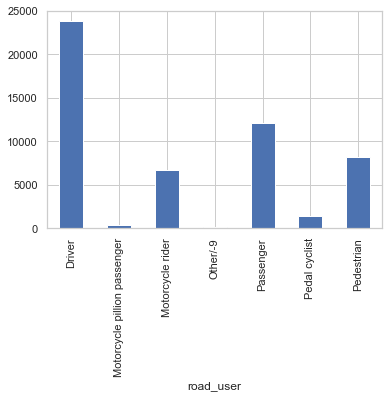

In [62]:
data.groupby('road_user')['id'].count().plot.bar();

To help understand the personas, we also analyzed the general levels of occurrences according to the profile of the person, where a result expected drivers to be the most affected predominates, indicating the possibility that a good part of the accidents happen with a single person in the vehicle.

Together with the average speed values found in the exploratory analysis (~80 km/h), we can consider the possibility of accidents happening on expressways/highways, where the maximum speed limit is higher.

## Conclusion:

According to the values found, there is a higher chance of having an accident according to the analysis:

•	Male drivers between 20 - 35 years old;

•	Routes where the maximum allowed speed is between 80 - 100 km/h.


#### With this information, what can we do to reduce these occurrences in the future?

•	Invest in the infrastructure of the roads (lighting, signaling);

•	Constant revision of speed limits;

•	Awareness campaigns on the road;

•	Campaigns focused on young people and encouraging the use of public transportation during holidays and vacations. If possible, public policies can be implemented to subsidize bus/plane/train tickets for students, the elderly, and disadvantaged socioeconomic groups;

•	Require defensive driving and first aid training for drivers (courses could be offered online for free);

•	Continue strict policy on alcohol and drug use for transit drivers (if necessary assess jail time for drivers caught with alcohol and drug levels in their bodies);

Note: for policy strategy formulation, more information will be needed than is available in the data set.

Thanks for reading!
